In [101]:
import numpy as np  
import pandas as pd  
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import string
import glob
from keras.utils import pad_sequences
from keras.preprocessing.text import Tokenizer
from keras.models import Model
from keras.layers import Flatten, Dense, LSTM, Dropout, Embedding, Activation
from keras.layers import concatenate, BatchNormalization, Input
from keras.layers import add
from keras.utils import to_categorical, plot_model, load_img, img_to_array
from keras.applications.inception_v3 import InceptionV3, preprocess_input
from skimage import io, transform
from IPython.display import display

In [102]:
def load_description(text):
	mapping = dict()
	for line in text.split("\n"):
		token = line.split("\t")
		if len(line) < 2: # remove short descriptions
			continue
		img_id = token[0].split('.')[0] # name of the image
		img_des = token[1]			 # description of the image
		if img_id not in mapping:
			mapping[img_id] = list()
		mapping[img_id].append(img_des)
	return mapping

token_path = './Flickr8K/Flickr_Data/Flickr_TextData/Flickr8k.token.txt'
text = open(token_path, 'r', encoding = 'utf-8').read()
descriptions = load_description(text)
print(descriptions['1000268201_693b08cb0e'])

['A child in a pink dress is climbing up a set of stairs in an entry way .', 'A girl going into a wooden building .', 'A little girl climbing into a wooden playhouse .', 'A little girl climbing the stairs to her playhouse .', 'A little girl in a pink dress going into a wooden cabin .']


In [103]:
def clean_description(desc):
	for key, des_list in desc.items():
		for i in range(len(des_list)):
			caption = des_list[i]
			caption = [ch for ch in caption if ch not in string.punctuation]
			caption = ''.join(caption)
			caption = caption.split(' ')
			caption = [word.lower() for word in caption if len(word)>1 and word.isalpha()]
			caption = ' '.join(caption)
			des_list[i] = caption

clean_description(descriptions)
descriptions['1000268201_693b08cb0e']

['child in pink dress is climbing up set of stairs in an entry way',
 'girl going into wooden building',
 'little girl climbing into wooden playhouse',
 'little girl climbing the stairs to her playhouse',
 'little girl in pink dress going into wooden cabin']

In [104]:
def to_vocab(desc):
	words = set()
	for key in desc.keys():
		for line in desc[key]:
			words.update(line.split())
	return words
vocab = to_vocab(descriptions)

In [105]:
images = './Flickr8K/Flickr_Data/Images/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

train_path = './Flickr8K/Flickr_Data/Flickr_TextData/Flickr_8k.trainImages.txt'
train_images = open(train_path, 'r', encoding = 'utf-8').read().split("\n")
train_img = [] # list of all images in training set
for im in img:
	if(im[len(images):] in train_images):
		train_img.append(im)

In [106]:
# load descriptions of training set in a dictionary. Name of the image will act as ey
def load_clean_descriptions(des, dataset):
	dataset_des = dict()
	for key, des_list in des.items():
		if key+'.jpg' in dataset:
			if key not in dataset_des:
				dataset_des[key] = list()
			for line in des_list:
				desc = 'startseq ' + line + ' endseq'
				dataset_des[key].append(desc)
	return dataset_des

train_descriptions = load_clean_descriptions(descriptions, train_images)
print(train_descriptions['1000268201_693b08cb0e'])

['startseq child in pink dress is climbing up set of stairs in an entry way endseq', 'startseq girl going into wooden building endseq', 'startseq little girl climbing into wooden playhouse endseq', 'startseq little girl climbing the stairs to her playhouse endseq', 'startseq little girl in pink dress going into wooden cabin endseq']


In [107]:
def preprocess_img(img_path):
	# inception v3 excepts img in 299 * 299 * 3
	img = load_img(img_path, target_size = (299, 299))
	x = img_to_array(img)
	# Add one more dimension
	x = np.expand_dims(x, axis = 0)
	x = preprocess_input(x)
	return x

def encode(image):
	image = preprocess_img(image)
	vec = encoding_model.predict(image, verbose=0)
	vec = np.reshape(vec, (vec.shape[1]))
	return vec

base_model = InceptionV3(weights = 'imagenet')
encoding_model = Model(base_model.input, base_model.layers[-2].output)

In [108]:
# run the encode function on all train images and store the feature vectors in a list
encoding_train = {}
for img in train_img:
	encoding_train[img[len(images):]] = encode(img)

In [109]:
# list of all training captions
all_train_captions = []
for key, val in train_descriptions.items():
	for caption in val:
		all_train_captions.append(caption)

# consider only words which occur atleast 10 times
vocabulary = vocab
threshold = 10 # you can change this value according to your need
word_counts = {}
for cap in all_train_captions:
	for word in cap.split(' '):
		word_counts[word] = word_counts.get(word, 0) + 1

vocab = [word for word in word_counts if word_counts[word] >= threshold]

# word mapping to integers
ixtoword = {}
wordtoix = {}

ix = 1
for word in vocab:
	wordtoix[word] = ix
	ixtoword[ix] = word
	ix += 1
	
# find the maximum length of a description in a dataset
max_length = max(len(des.split()) for des in all_train_captions)
max_length

34

In [110]:
X1, X2, y = list(), list(), list()
vocab_size = len(vocab)+1
for key, des_list in train_descriptions.items():
	pic = encoding_train[key + '.jpg']
	for cap in des_list:
		seq = [wordtoix[word] for word in cap.split(' ') if word in wordtoix]
		for i in range(1, len(seq)):
			in_seq, out_seq = seq[:i], seq[i]
			in_seq = pad_sequences([in_seq], maxlen = max_length)[0]
			out_seq = to_categorical([out_seq], num_classes = vocab_size)[0]
			# store
			X1.append(pic)
			X2.append(in_seq)
			y.append(out_seq)

X2 = np.array(X2)
X1 = np.array(X1)
y = np.array(y)

# load glove vectors for embedding layer
embeddings_index = {}
golve_path ='./Glove-Global-Vector-for-Word-Representation/glove.6B.200d.txt'
glove = open(golve_path, 'r', encoding = 'utf-8').read()
for line in glove.split("\n"):
	values = line.split(" ")
	word = values[0]
	indices = np.asarray(values[1: ], dtype = 'float32')
	embeddings_index[word] = indices

emb_dim = 200
emb_matrix = np.zeros((vocab_size, emb_dim))
for word, i in wordtoix.items():
	emb_vec = embeddings_index.get(word)
	if emb_vec is not None:
		emb_matrix[i] = emb_vec
emb_matrix.shape

(1652, 200)

In [111]:
# define the model
ip1 = Input(shape = (2048, ))
fe1 = Dropout(0.2)(ip1)
fe2 = Dense(256, activation = 'relu')(fe1)
ip2 = Input(shape = (max_length, ))
se1 = Embedding(vocab_size, emb_dim, mask_zero = True)(ip2)
se2 = Dropout(0.2)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
decoder2 = Dense(256, activation = 'relu')(decoder1)
outputs = Dense(vocab_size, activation = 'softmax')(decoder2)
model = Model(inputs = [ip1, ip2], outputs = outputs)

In [112]:
model.layers[2].set_weights([emb_matrix])
model.layers[2].trainable = False
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam')
model.fit([X1, X2], y, epochs = 15, batch_size = 256)
# you can increase the number of epochs for better results

Epoch 1/15
1142/1142 [==============================] - 1260s 1s/step - loss: 3.8997
Epoch 2/15
1142/1142 [==============================] - 1295s 1s/step - loss: 3.1597
Epoch 3/15
1142/1142 [==============================] - 1296s 1s/step - loss: 2.9243
Epoch 4/15
1142/1142 [==============================] - 1402s 1s/step - loss: 2.7726
Epoch 5/15
1142/1142 [==============================] - 1215s 1s/step - loss: 2.6585
Epoch 6/15
1142/1142 [==============================] - 1250s 1s/step - loss: 2.5652
Epoch 7/15
 360/1142 [========>.....................] - ETA: 15:48 - loss: 2.4534

KeyboardInterrupt: 

In [113]:
def greedy_search(pic):
	start = 'startseq'
	for i in range(max_length):
		seq = [wordtoix[word] for word in start.split() if word in wordtoix]
		seq = pad_sequences([seq], maxlen = max_length)
		yhat = model.predict([pic, seq], verbose=0)
		yhat = np.argmax(yhat)
		word = ixtoword[yhat]
		start += ' ' + word
		if word == 'endseq':
			break
	final = start.split()
	final = final[1:-1]
	final = ' '.join(final)
	return final

In [114]:
images = './Flickr8K/Flickr_Data/Images/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

test_path = './Flickr8K/Flickr_Data/Flickr_TextData/Flickr_8k.testImages.txt'
test_images = open(test_path, 'r', encoding = 'utf-8').read().split("\n")
test_img = [] # list of all images in training set
for im in img:
	if(im[len(images):] in test_images):
		test_img.append(im)
        
test_img = test_img[:50]

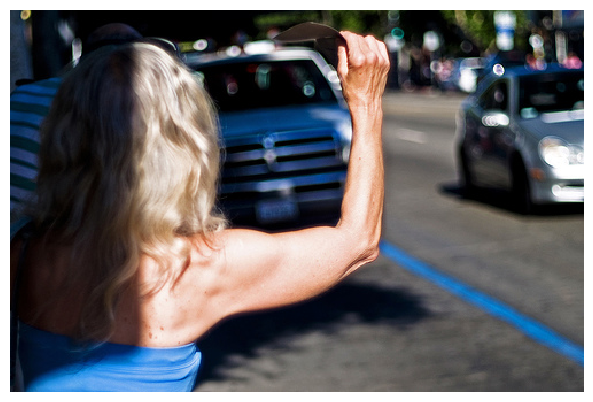

the boy in the blue shirt is wearing blue and yellow gloves


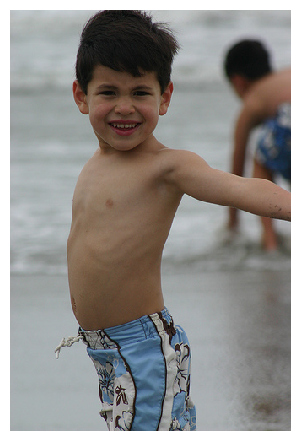

boy in swim trunks is in the water


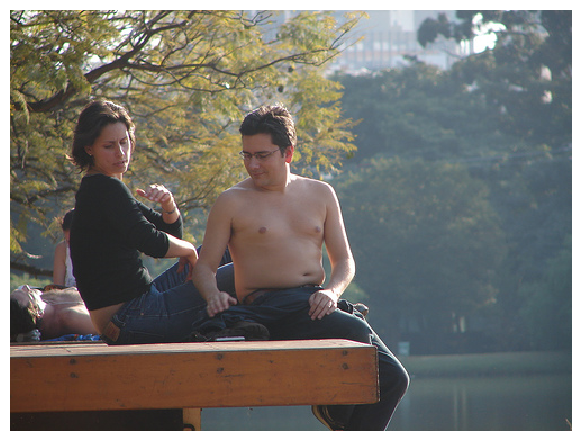

man in blue shirt and no shirt is sitting on bench with his feet up


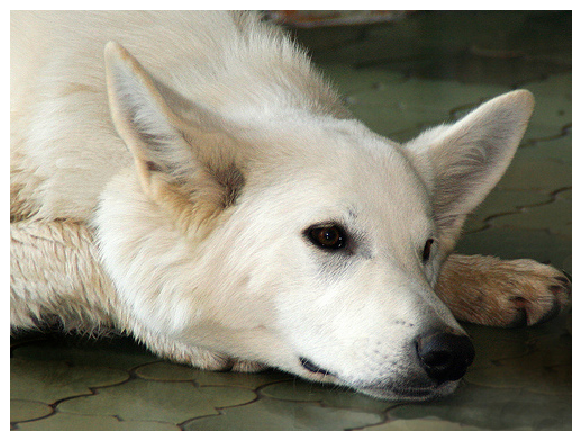

dog is running through the water


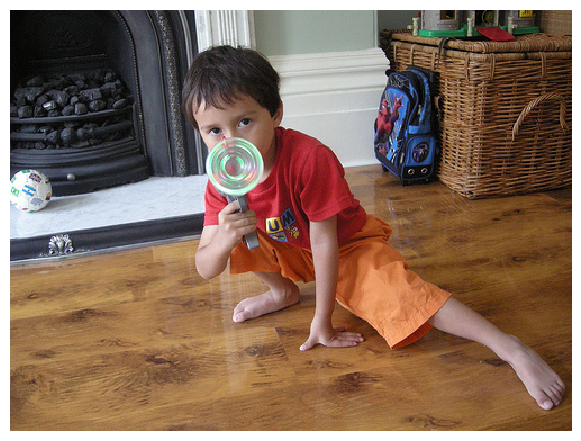

little boy in blue shirt and blue shorts is holding onto


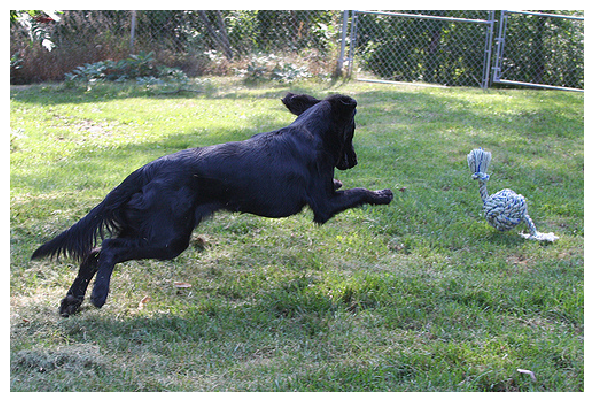

black dog is running through the grass


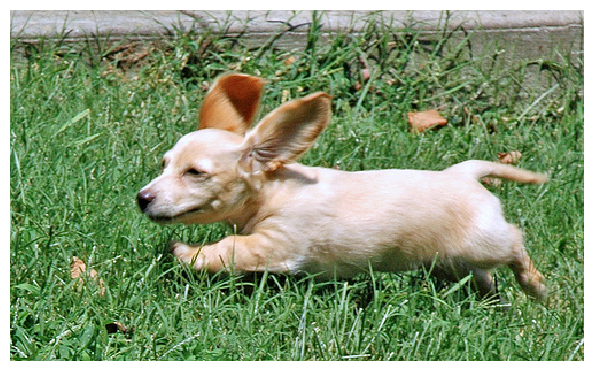

the dog is running through the grass


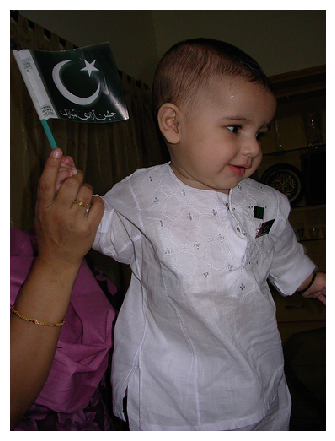

man in blue shirt and glasses is holding onto his tongue


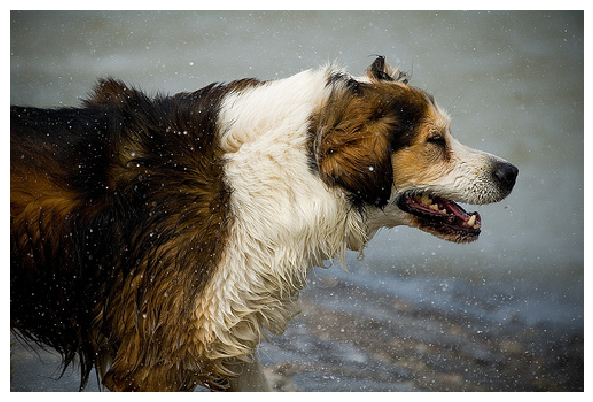

dog is running through the water


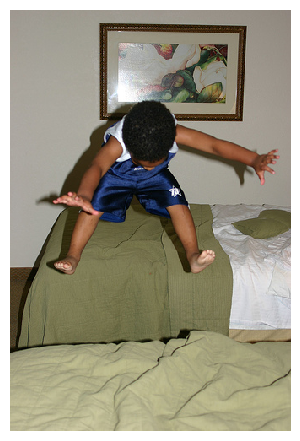

girl in red shirt is climbing rock wall


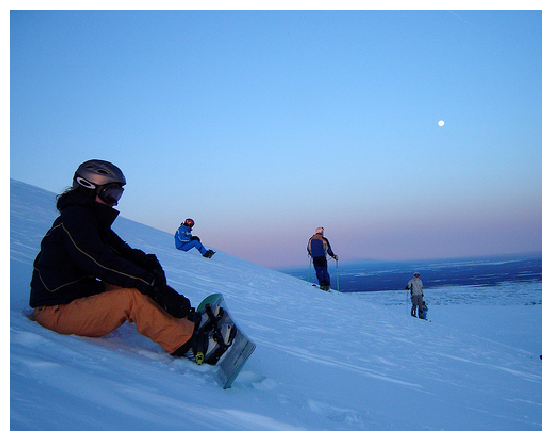

person in red jacket and blue hat is on the side of the mountain


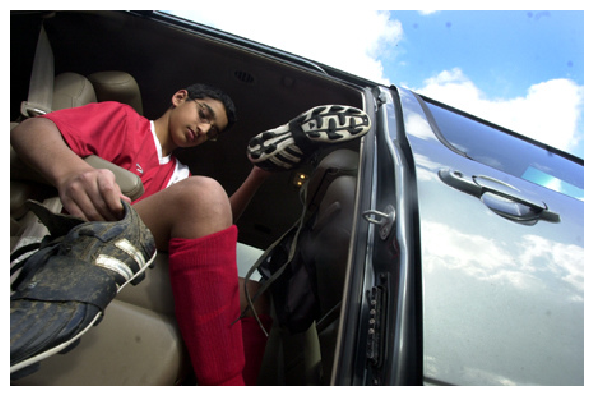

man in blue shorts and woman in blue shorts and red shorts are pulling jeep in the street


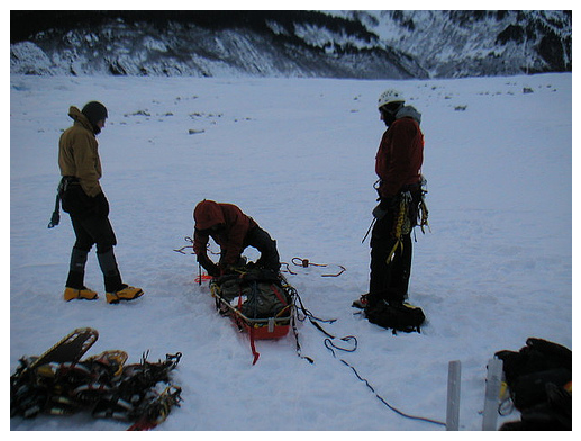

two people are pulling sled through the snow


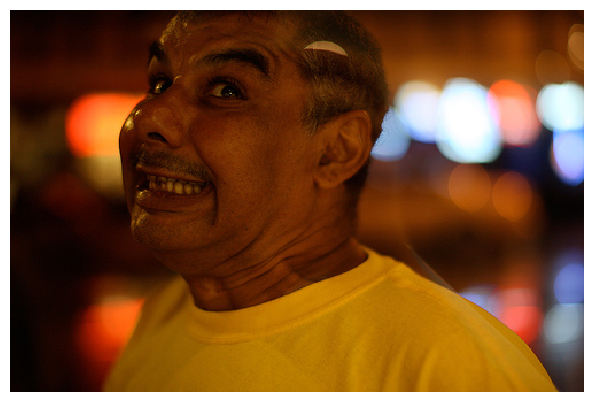

man with mohawk and nose


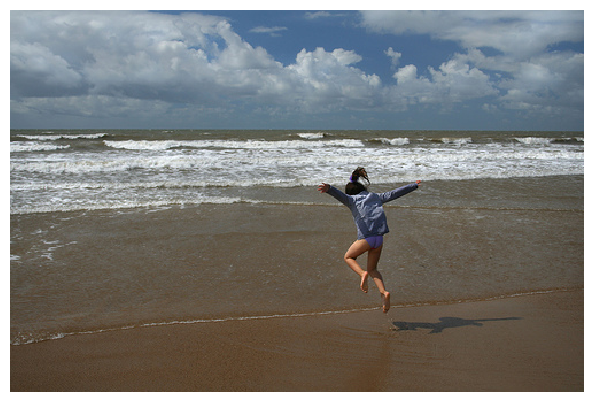

girl in red shorts runs along the beach


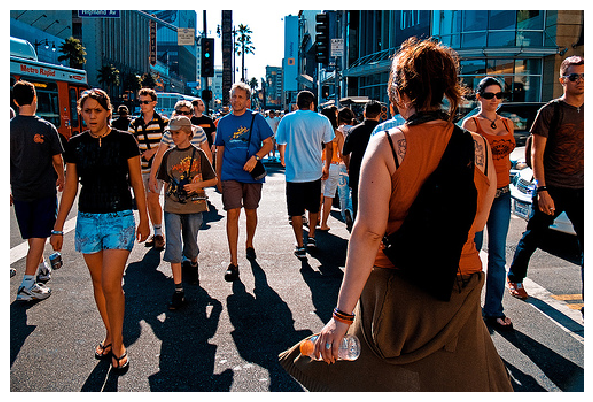

group of people walk in the street


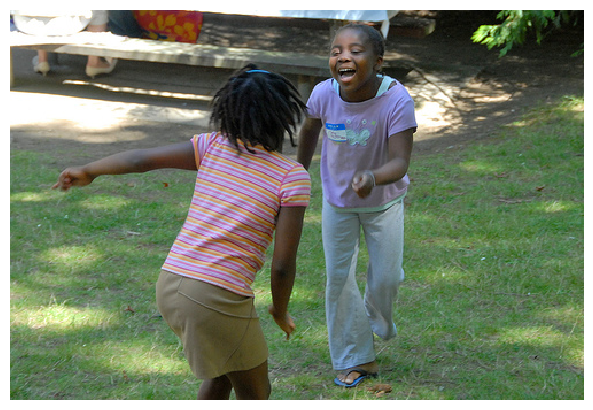

little boy in red shirt and blue shorts is walking on the sidewalk


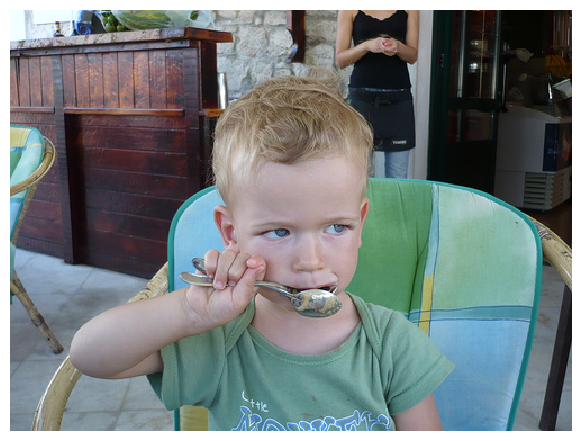

little boy is playing with water


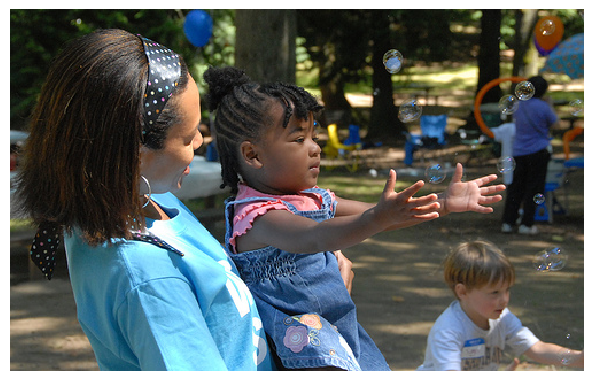

two girls in pink dresses are looking at something in the air


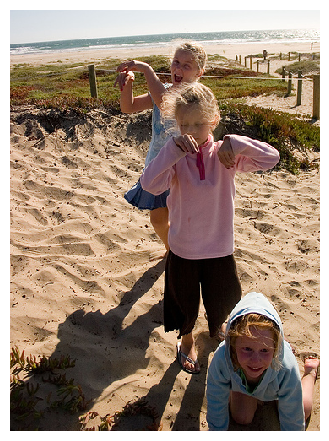

little boy in blue shirt and blue shorts plays in the sand


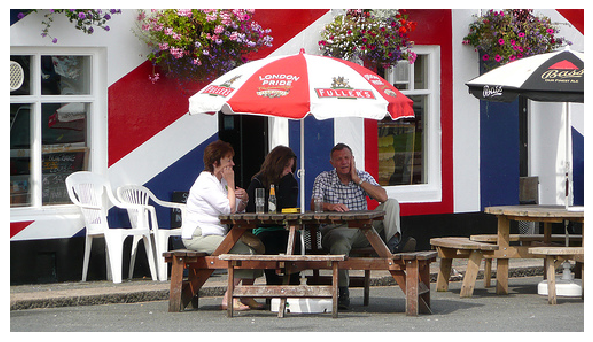

man is sitting in front of an open bus


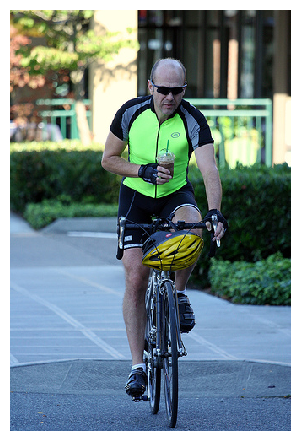

man in yellow jacket riding bike down road


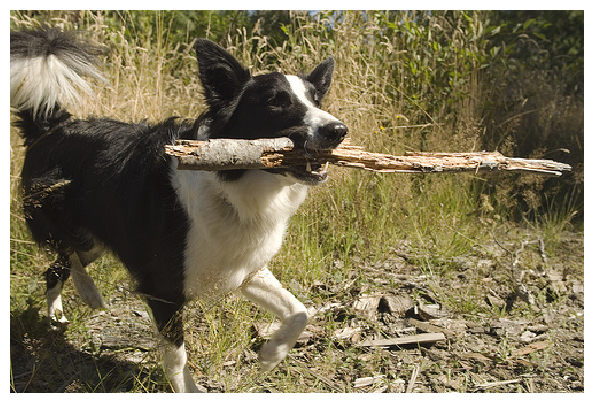

dog is running through the grass


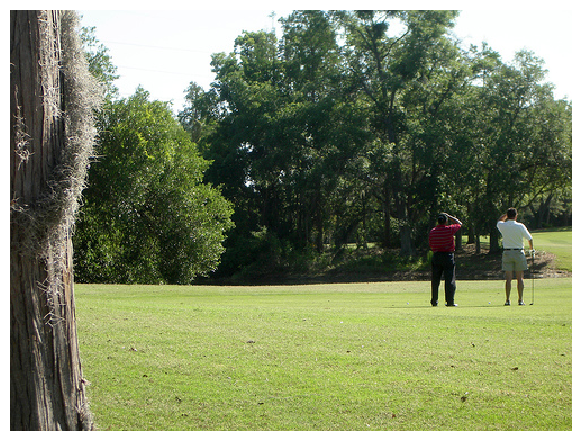

two young girls in black shirts are standing in front of row of trees


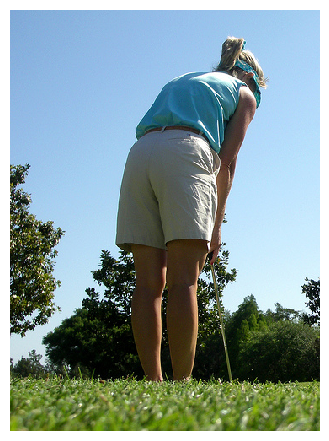

little girl in pink shirt is walking through the grass


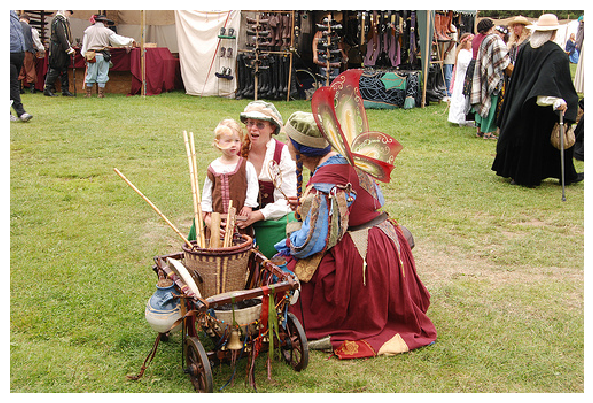

woman in pink dress is carrying baby in her mouth while woman in pink watches her


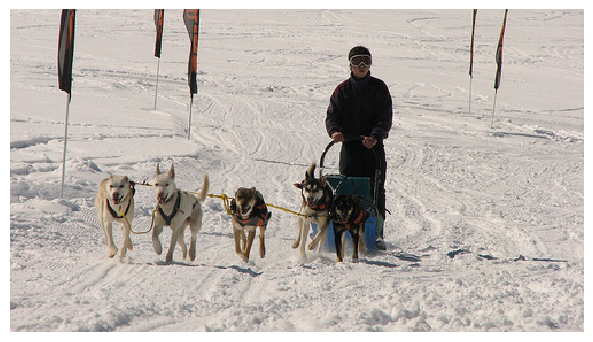

two people are pulling sled down road


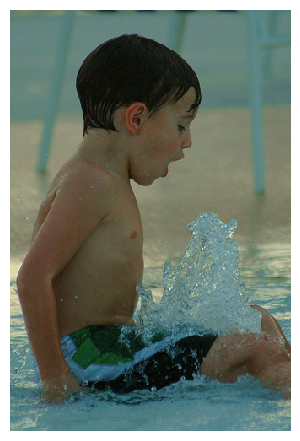

young boy in swimsuit swimming


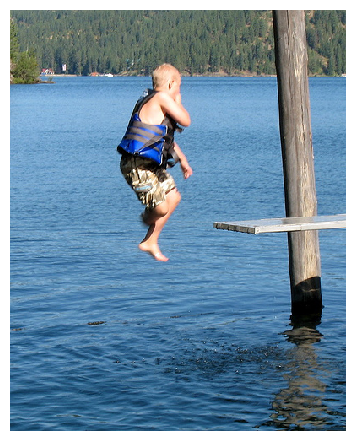

woman in black and white shorts and white shorts is jumping into lake


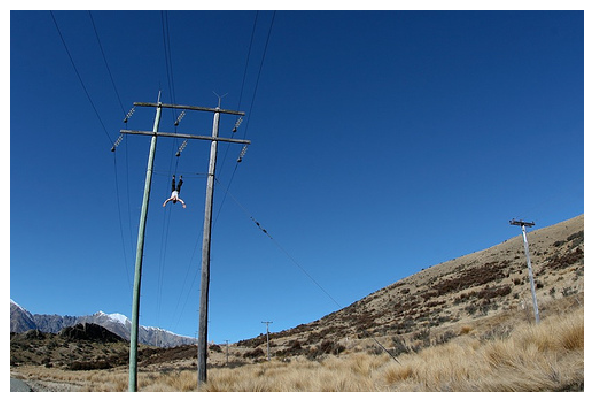

person is riding bike on the edge of snowy hill


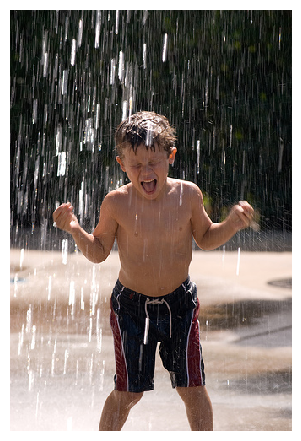

young boy in green shirt and blue shorts is playing in the sprinklers


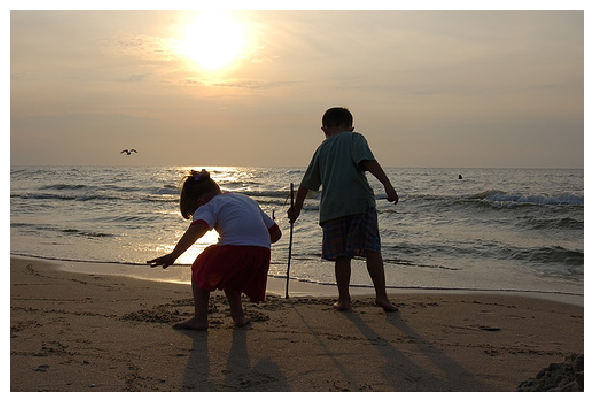

man and woman are walking on the beach


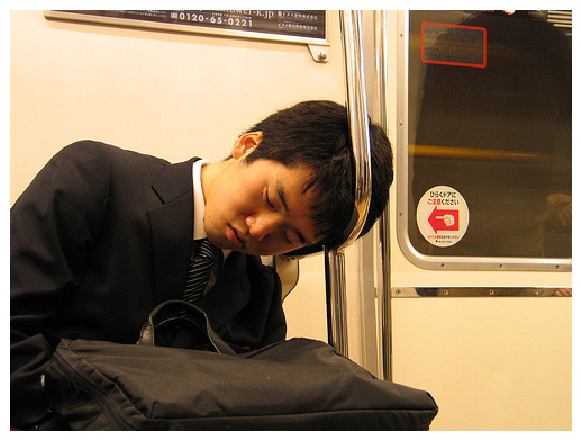

man in blue shirt and black pants is sitting in front of window


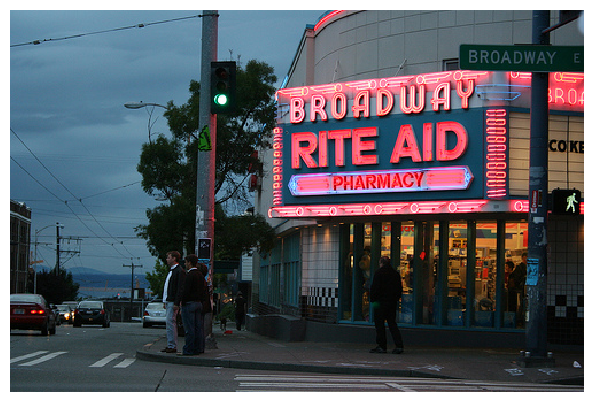

woman in blue shirt is standing in front of restaurant


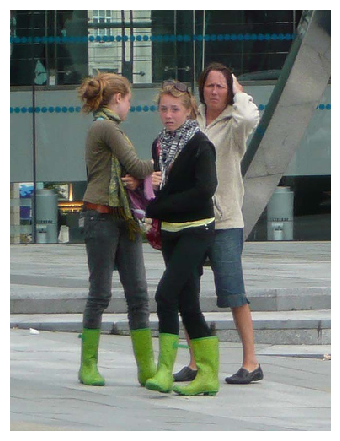

two people walking on sidewalk


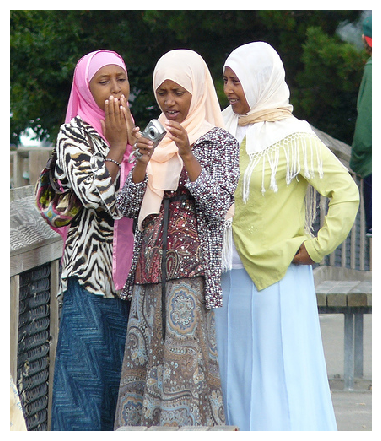

two women in costumes


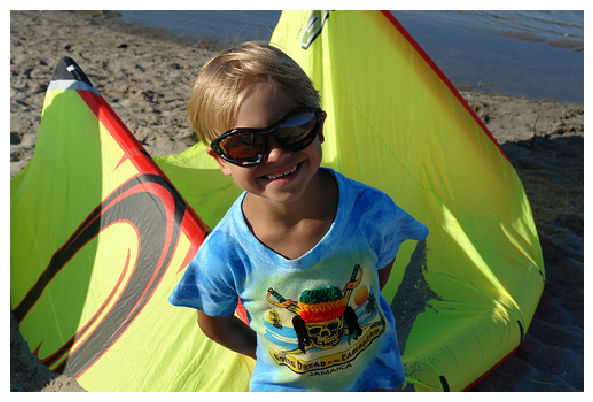

young boy in swimming trunks is on the beach


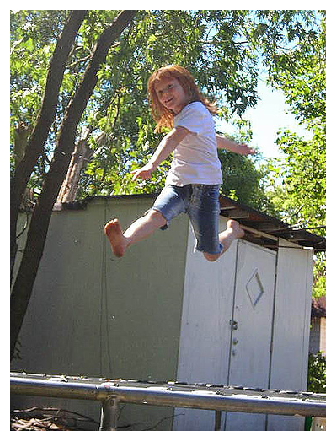

man in blue shirt and blue shorts is jumping up to balance concrete wall


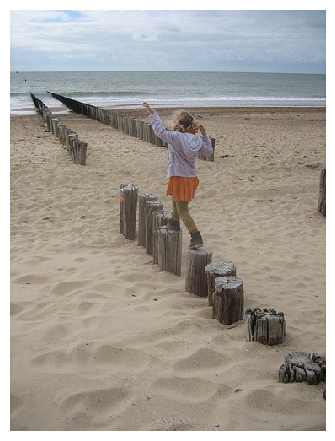

two people are sitting on the beach by the ocean


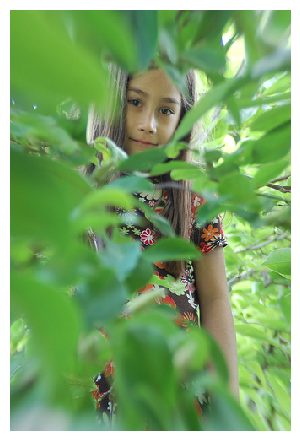

little girl in pink dress is standing between tree


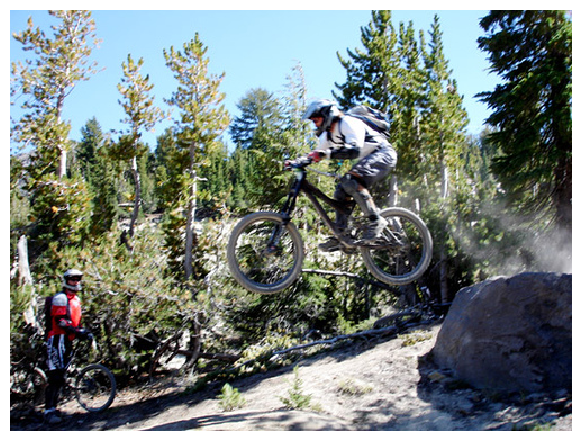

biker riding through forest


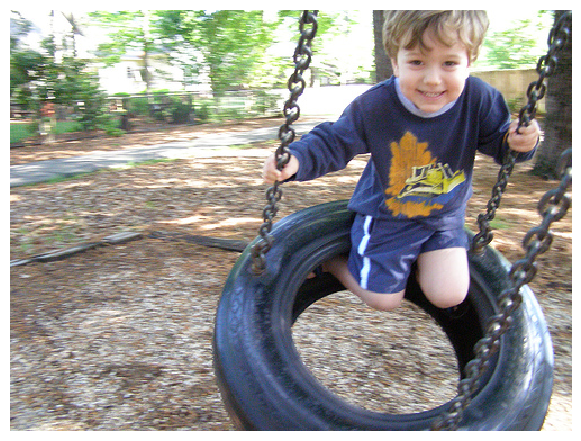

little boy in green shirt is swinging on swing


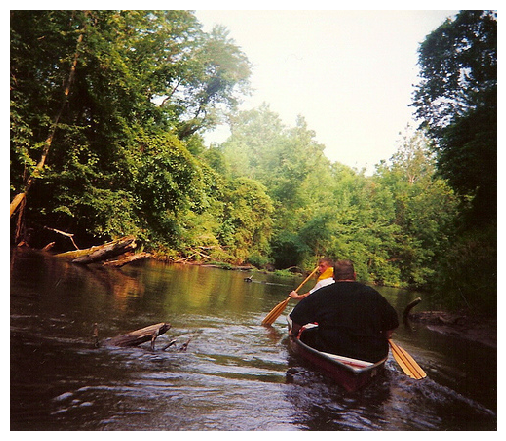

man in green jacket is standing in front of lake


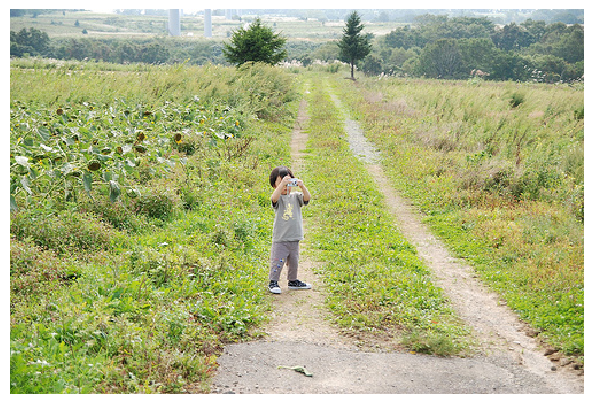

two people in field


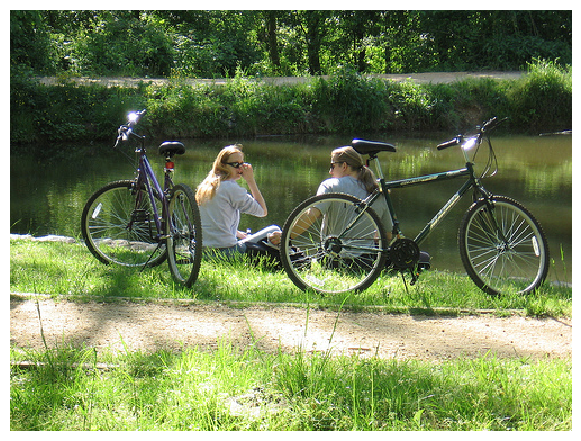

man riding bike down road


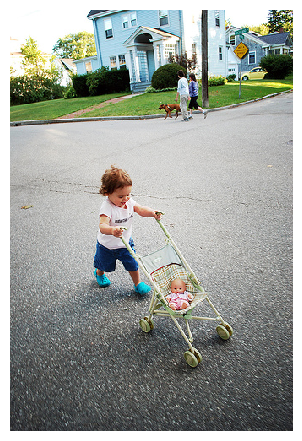

little girl in pink dress is pushing the hula hoop on the sidewalk


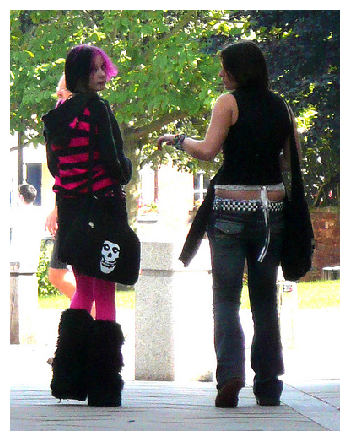

woman in black dress and black hat is standing in front of building


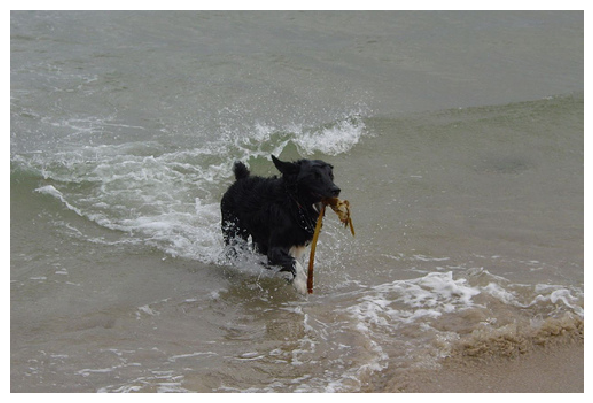

black dog is running through the water


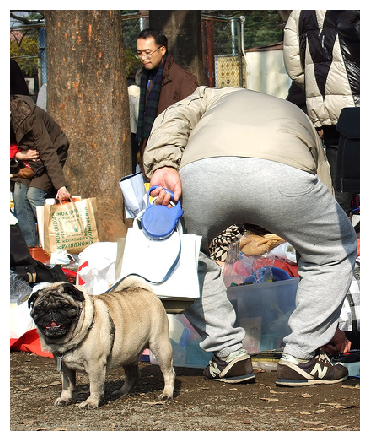

two men are sitting on the ground


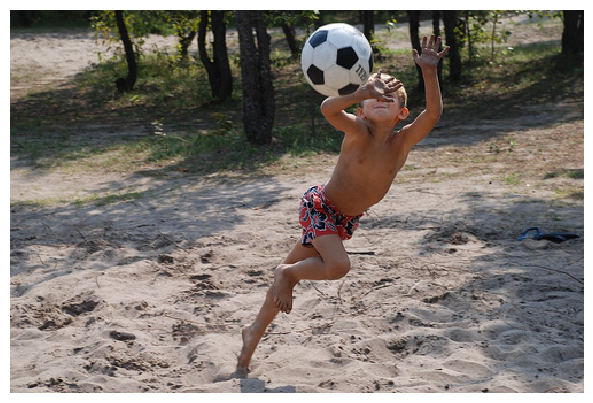

two young boys playing soccer in the sand


In [115]:
for img in test_img:

    pic = np.array(encode(img)).reshape(1, -1)
    image = io.imread(img)
    # Display the resized image
    io.imshow(image)
    plt.axis("off")
    plt.show()
    # Generate the caption and display it
    caption = greedy_search(pic)
    print(caption)